# <span style="color:Green">Комментарий от наставника</span>

Привет, меня зовут Дмитрий, наставник в твоей группе. Мои комментарии - <span style="color:DarkGreen">**зеленого**</span> цвета, со временной меткой формата **YYYY-MM-DD**.

</span>

# Описание проекта

Подготовьте прототип модели машинного обучения для «Цифры». Компания разрабатывает решения для эффективной работы промышленных предприятий.

Модель должна предсказать коэффициент восстановления золота из золотосодержащей руды. В вашем распоряжении данные с параметрами добычи и очистки. 

Модель поможет оптимизировать производство, чтобы не запускать предприятие с убыточными характеристиками.

Вам нужно:

1. Подготовить данные;
2. Провести исследовательский анализ данных;
3. Построить и обучить модель.

Чтобы выполнить проект, обращайтесь к библиотекам *pandas*, *matplotlib* и *sklearn.* Вам поможет их документация.

# 1. Подготовка данных

Импорт библиотек

In [39]:
import pandas as pd
import numpy as np 
import os 
from sklearn.metrics import mean_absolute_error
import matplotlib.pyplot as plt 
import seaborn as sns; sns.set()
from scipy import stats
from sklearn.model_selection import cross_val_score
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.linear_model import LinearRegression
from sklearn.metrics.scorer import make_scorer
import math
from pathlib import Path
path = Path.cwd()

Константы

In [40]:
PATH_TO_DATA = '{}/datasets/'.format(path)
RANDOM_STATE = 12345
features_columns = ['primary_cleaner.input.sulfate', 'primary_cleaner.input.depressant', 'primary_cleaner.input.feed_size', 'primary_cleaner.input.xanthate', 'primary_cleaner.state.floatbank8_a_air', 'primary_cleaner.state.floatbank8_a_level', 'primary_cleaner.state.floatbank8_b_air', 'primary_cleaner.state.floatbank8_b_level', 'primary_cleaner.state.floatbank8_c_air', 'primary_cleaner.state.floatbank8_c_level', 'primary_cleaner.state.floatbank8_d_air', 'primary_cleaner.state.floatbank8_d_level', 'rougher.input.feed_ag', 'rougher.input.feed_pb', 'rougher.input.feed_rate', 'rougher.input.feed_size', 'rougher.input.feed_sol', 'rougher.input.feed_au', 'rougher.input.floatbank10_sulfate', 'rougher.input.floatbank10_xanthate', 'rougher.input.floatbank11_sulfate', 'rougher.input.floatbank11_xanthate', 'rougher.state.floatbank10_a_air', 'rougher.state.floatbank10_a_level', 'rougher.state.floatbank10_b_air', 'rougher.state.floatbank10_b_level', 'rougher.state.floatbank10_c_air', 'rougher.state.floatbank10_c_level', 'rougher.state.floatbank10_d_air', 'rougher.state.floatbank10_d_level', 'rougher.state.floatbank10_e_air', 'rougher.state.floatbank10_e_level', 'rougher.state.floatbank10_f_air', 'rougher.state.floatbank10_f_level', 'secondary_cleaner.state.floatbank2_a_air', 'secondary_cleaner.state.floatbank2_a_level', 'secondary_cleaner.state.floatbank2_b_air', 'secondary_cleaner.state.floatbank2_b_level', 'secondary_cleaner.state.floatbank3_a_air', 'secondary_cleaner.state.floatbank3_a_level', 'secondary_cleaner.state.floatbank3_b_air', 'secondary_cleaner.state.floatbank3_b_level', 'secondary_cleaner.state.floatbank4_a_air', 'secondary_cleaner.state.floatbank4_a_level', 'secondary_cleaner.state.floatbank4_b_air', 'secondary_cleaner.state.floatbank4_b_level', 'secondary_cleaner.state.floatbank5_a_air', 'secondary_cleaner.state.floatbank5_a_level', 'secondary_cleaner.state.floatbank5_b_air', 'secondary_cleaner.state.floatbank5_b_level', 'secondary_cleaner.state.floatbank6_a_air', 'secondary_cleaner.state.floatbank6_a_level']

Функции

In [41]:
def preparing(name):
    filename = 'gold_recovery_' + name + '.csv'
    df = pd.read_csv(os.path.join(PATH_TO_DATA, filename), parse_dates=['date'])
    df['month'] = df['date'].dt.month
    df['year'] = df['date'].dt.year
    df['doy'] = df['date'].dt.dayofyear
    return df 

# Расчет эффективности обогащения
def recovery(c, f, t, is_with_limits):
    if c == t:
        result = np.nan
    elif f == 0:
        result = np.nan
    else:
        result = (c*(f-t))/(f*(c-t))*100
        if is_with_limits == True:
            if result < 0 or result > 100:
                result = np.nan
    return result

def calculate_recovery(row):
    c = row['rougher.output.concentrate_au']
    f = row['rougher.input.feed_au']
    t = row['rougher.output.tail_au']
    return recovery(c, f, t, False)

def calculate_recovery_with_limits(row):
    c = row['rougher.output.concentrate_au']
    f = row['rougher.input.feed_au']
    t = row['rougher.output.tail_au']
    return recovery(c, f, t, True)

def preprocessing_dropna(df):
    return df.dropna()

# Расчет суммарной концентрации золота, серебра и свинца
def calculate_total_concentrate(df):
    df['final.output.concentrate_all'] = df[['final.output.concentrate_ag', 'final.output.concentrate_pb', 'final.output.concentrate_au']].sum(1)
    df['primary_cleaner.output.concentrate_all'] = df[['primary_cleaner.output.concentrate_ag', 'primary_cleaner.output.concentrate_pb',  'primary_cleaner.output.concentrate_au']].sum(1)
    df['rougher.output.concentrate_all'] = df[['rougher.output.concentrate_ag', 'rougher.output.concentrate_pb', 'rougher.output.concentrate_au']].sum(1)
    return df

def concentrate_error(row):
    a = row[0]
    b = row[1]
    c = row[2]
    if b < a:
        return True
    elif c < b:
        return True
    return False

# Удаление данных с ошибочной концентрацией
def drop_concentrate_error(df):
    df = calculate_total_concentrate(df)
    df['concentrate_error'] = df[['rougher.output.concentrate_all', 'primary_cleaner.output.concentrate_all', 'final.output.concentrate_all']].apply(concentrate_error, axis=1)
    df = df[df.concentrate_error == False]
    return df

# Расчет sMAPE
def calculate_smape(target, prediction):
    target = target.to_list()
    count = len(target)
    total = 0
    for i in range(count):
        up = abs(target[i] - prediction[i])
        down = (abs(target[i]) + abs(prediction[i]))/2
        if down == 0 or math.isnan(target[i]) or math.isnan(prediction[i]):
            total = total
        else:
            total = total + up/down
    mean = total/count
    return mean*100

def drop_columns(df):
    df = df.drop(columns = ['final.output.concentrate_ag',  'final.output.concentrate_au',  'final.output.concentrate_pb',  'final.output.concentrate_sol', 'final.output.tail_ag',  'final.output.tail_au',  'final.output.tail_pb',  'final.output.tail_sol',  'primary_cleaner.output.concentrate_ag',  'primary_cleaner.output.concentrate_au',  'primary_cleaner.output.concentrate_pb',  'primary_cleaner.output.concentrate_sol',  'primary_cleaner.output.tail_ag',  'primary_cleaner.output.tail_au',  'primary_cleaner.output.tail_pb',  'primary_cleaner.output.tail_sol',  'rougher.calculation.au_pb_ratio',  'rougher.calculation.floatbank10_sulfate_to_au_feed',  'rougher.calculation.floatbank11_sulfate_to_au_feed',  'rougher.calculation.sulfate_to_au_concentrate',  'rougher.output.concentrate_ag',  'rougher.output.concentrate_au',  'rougher.output.concentrate_pb',  'rougher.output.concentrate_sol', 'rougher.output.tail_ag',  'rougher.output.tail_au',  'rougher.output.tail_pb',  'rougher.output.tail_sol',  'secondary_cleaner.output.tail_ag',  'secondary_cleaner.output.tail_au',  'secondary_cleaner.output.tail_pb',  'secondary_cleaner.output.tail_sol']) 
    return df

# Масштабируем признаки
def scaling(features, numeric):
    scaler = StandardScaler()
    scaler.fit(features[numeric])
    features_scalar = features.copy()
    features_scalar.loc[:, numeric] = scaler.transform(features[numeric])
    return features_scalar

def calculate_cross_val_smape_score(model, features, target):
    score = make_scorer(calculate_smape, greater_is_better=True)
    return cross_val_score(model, features, target, scoring=score, cv=3).mean()

# Расчет итогового sMAPE для кросс-валидации
def calculate_cross_val_result_smape_score(model, features, target1, target2):
    score1 = calculate_cross_val_smape_score(model, features, target1)
    score2 = calculate_cross_val_smape_score(model, features, target2)
    score_total = score1 * 0.25 + score2 * 0.75
    return score_total




<span style="color:Green">

**2019-12-29 DD**

Определение функций подобие выше - отличная практика. Немного наблюдений:
- concentrate_error: снижение концентрации - всегда ли ошибка? Это отлично, что ты пытаешься отловить такие случаи, но они могут быть следствием техпроцесса и быть не ошибками, а его особенностями.
- calculate_smape: функцию можно написать без использования циклов. Если в неё передавать объекты типа pandas.series или numpy.array, то арифметические операции над ними могут выполняться без циклов, как над векторами.
- scaling: здесь, скрывается потенциал для грубой ошибки, когда StandardScaler будет применяться индивидуально и к трейну, и к тесту. Но! т.к. мы полагаем, что это выборки ид одной генеральной совокупности, то StandardScaler должен "обучиться" (fit) на трейне, а потом применятся и к трейну (transform), и к тесту (transform). Из-за этого у тебя ниже некоторые метрики могут иметь немного другие значения, чем должны.

</span>

In [42]:
train = preparing('train')
test = preparing('test')
full = preparing('full')
train.info()
test.info()
full.info()

.output.concentrate_ag               16778 non-null  float64       
 16  primary_cleaner.output.concentrate_pb               16502 non-null  float64       
 17  primary_cleaner.output.concentrate_sol              16224 non-null  float64       
 18  primary_cleaner.output.concentrate_au               16778 non-null  float64       
 19  primary_cleaner.output.tail_ag                      16777 non-null  float64       
 20  primary_cleaner.output.tail_pb                      16761 non-null  float64       
 21  primary_cleaner.output.tail_sol                     16579 non-null  float64       
 22  primary_cleaner.output.tail_au                      16777 non-null  float64       
 23  primary_cleaner.state.floatbank8_a_air              16820 non-null  float64       
 24  primary_cleaner.state.floatbank8_a_level            16827 non-null  float64       
 25  primary_cleaner.state.floatbank8_b_air              16820 non-null  float64       
 26  primary_cleaner.state.floatbank8_b_level       

В train и full по 87 колонок, в test только 53. Выведем список отсутствующих колонок

In [43]:
print('Разница full и train')
set(full.columns) - set(train.columns)
print('Разница full и test')
set(full.columns) - set(test.columns)

Разница full и train
Разница full и test


{'final.output.concentrate_ag',
 'final.output.concentrate_au',
 'final.output.concentrate_pb',
 'final.output.concentrate_sol',
 'final.output.recovery',
 'final.output.tail_ag',
 'final.output.tail_au',
 'final.output.tail_pb',
 'final.output.tail_sol',
 'primary_cleaner.output.concentrate_ag',
 'primary_cleaner.output.concentrate_au',
 'primary_cleaner.output.concentrate_pb',
 'primary_cleaner.output.concentrate_sol',
 'primary_cleaner.output.tail_ag',
 'primary_cleaner.output.tail_au',
 'primary_cleaner.output.tail_pb',
 'primary_cleaner.output.tail_sol',
 'rougher.calculation.au_pb_ratio',
 'rougher.calculation.floatbank10_sulfate_to_au_feed',
 'rougher.calculation.floatbank11_sulfate_to_au_feed',
 'rougher.calculation.sulfate_to_au_concentrate',
 'rougher.output.concentrate_ag',
 'rougher.output.concentrate_au',
 'rougher.output.concentrate_pb',
 'rougher.output.concentrate_sol',
 'rougher.output.recovery',
 'rougher.output.tail_ag',
 'rougher.output.tail_au',
 'rougher.output.ta

Колонки в full и train совпадают. В test нет всех output и calculation параметров и есть все input и state. Судя по описанию в test нет данных которые становятся известны позже<br>
Проверим данные на адекватность. Рассчитаем rougher.output.recovery и сравним с фактическим

In [44]:
train = preparing('train')
train['rougher.output.recovery.calculate'] =  train.apply(calculate_recovery, axis=1)
mean_absolute_error(train['rougher.output.recovery'].fillna(0).round(6), train['rougher.output.recovery.calculate'].fillna(0).round(6))

48.73524134365362

<span style="color:Green">

**2019-12-29 DD**

Здесь, у тебя получается немного запутанно вследствии того, что пропуски заполняются нулями. Подсчитай ошибку только для тех строк, для которых есть и rougher.output.recovery.calculate, и, соответственно, rougher.output.recovery.calculate.

Я ниже привёл такой расчёт. Любопытства ради можно ещё вывести и распределение значений данной ошибки.

</span>

In [45]:
mean_absolute_error(train[~train['rougher.output.recovery'].isna()]['rougher.output.recovery'], 
                    train[~train['rougher.output.recovery'].isna()]['rougher.output.recovery.calculate'])

9.663222059087804e-15

Средняя ошибка  48.7. Попробуем понять много это или мало

In [46]:
train['rougher.output.recovery'].describe()

count    14287.000000
mean        82.394201
std         15.096808
min          0.000000
25%         79.818372
50%         85.235997
75%         90.131691
max        100.000000
Name: rougher.output.recovery, dtype: float64

rougher.output.recovery лежит в диапазоне \[0, 100\], это логично для эффективности. Посмотрим на распределение rougher.output.recovery.calculate

In [47]:
train['rougher.output.recovery.calculate'].describe()

count     14547.000000
mean         31.414147
std        3302.773106
min     -366924.161290
25%          79.704808
50%          85.229912
75%          90.203432
max       13802.071756
Name: rougher.output.recovery.calculate, dtype: float64

Рассчетная эффективность не вписывается в ограничения логики. Добавим в функцию ограничение: если расчетное значение меньше 0 или больше 100, то значение recovery = NaN

In [48]:
train = preparing('train')
train['rougher.output.recovery.calculate'] =  train.apply(calculate_recovery_with_limits, axis=1)
mean_absolute_error(train['rougher.output.recovery'].fillna(0).round(6), train['rougher.output.recovery.calculate'].fillna(0).round(6))

0.0

MAE=0 при учёте лимитов. Какие выводы можно сделать: 1. в данных есть ошибки, иначе расчетное значение всегда было от 0 до 100 2. при расчете recovery учитывается возможность ошибки, это заложено на уровне логики расчета и/или на уровне базы данных

Для первого прохода сделаем самый простой вариант предобработки: дропнем все пустые значения

In [49]:
train = preparing('train')
train = preprocessing_dropna(train)

# 2. Анализ данных

Text(0.5, 1.0, 'Ag')

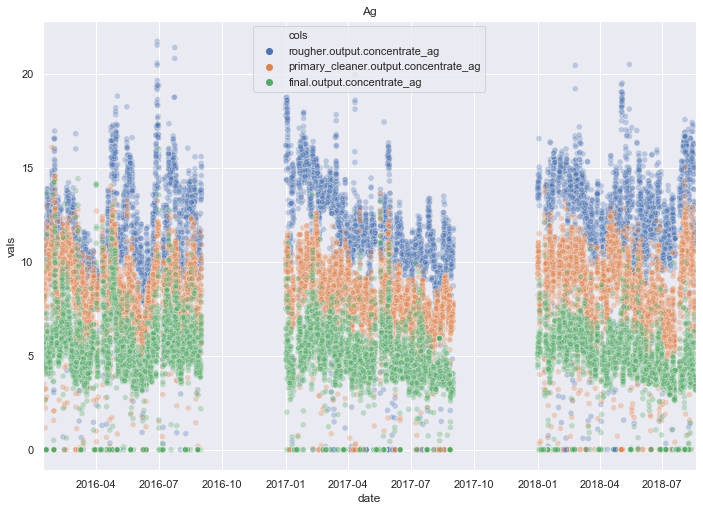

In [50]:
train = preparing('train')
sns.set(rc={'figure.figsize':(11.7,8.27)})
train = train.sample(10000) # без ограничений долго строит
train = train[['date', 'rougher.output.concentrate_ag', 'primary_cleaner.output.concentrate_ag', 'final.output.concentrate_ag']].melt('date', var_name='cols', value_name='vals')
ax = sns.scatterplot(x='date', y='vals', hue='cols', data=train, alpha=0.3)
ax.set_xlim(train['date'].min(), train['date'].max())
ax.set_title('Ag')

Text(0.5, 1.0, 'Pb')

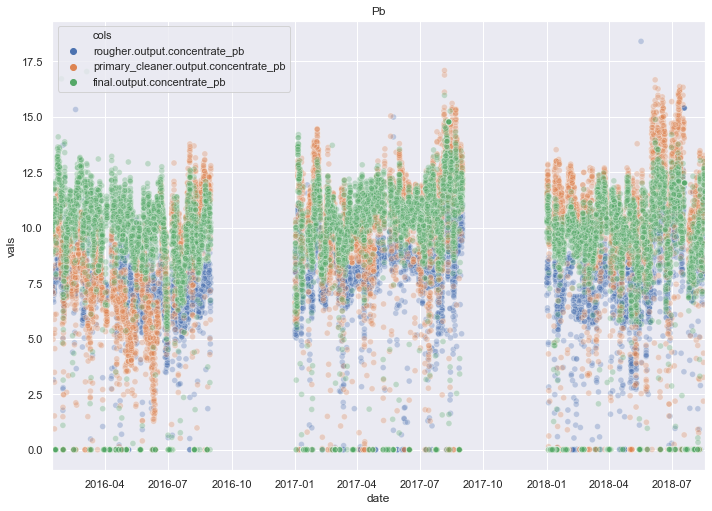

In [51]:
train = preparing('train')
sns.set(rc={'figure.figsize':(11.7,8.27)})
train = train.sample(10000) # без ограничений долго строит
train = train[['date', 'rougher.output.concentrate_pb', 'primary_cleaner.output.concentrate_pb', 'final.output.concentrate_pb']].melt('date', var_name='cols', value_name='vals')
ax = sns.scatterplot(x='date', y='vals', hue='cols', data=train, alpha=0.3)
ax.set_xlim(train['date'].min(), train['date'].max())
ax.set_title('Pb')

Text(0.5, 1.0, 'Au')

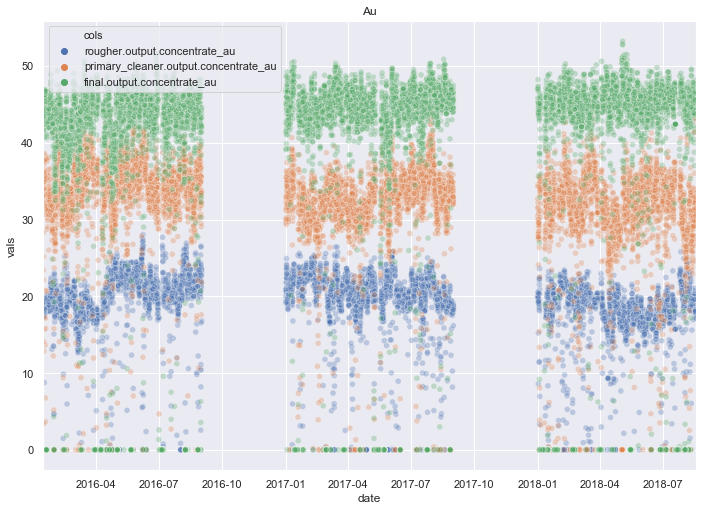

In [52]:
train = preparing('train')
sns.set(rc={'figure.figsize':(11.7,8.27)})
train = train.sample(10000) # без ограничений долго строит
train = train[['date', 'rougher.output.concentrate_au', 'primary_cleaner.output.concentrate_au', 'final.output.concentrate_au']].melt('date', var_name='cols', value_name='vals')
ax = sns.scatterplot(x='date', y='vals', hue='cols', data=train, alpha=0.3)
ax.set_xlim(train['date'].min(), train['date'].max())
ax.set_title('Au')

Что видим на графиках:
* данные за 3 года. год к году картина принципиально не меняется
* концентрация золота по мере очистки растет(логично для золотообрабатывающего предприятия)
* концентрация серебра падает
* концентрация свинца вроде бы не меняется. проверим с помощью ttest_ind меняется ли средняя концентрация свинца по ходу обработки

<span style="color:Green">

**2019-12-29 DD**

Здорово, что постарался посмотреть в динамике (за разные временные периоды). Графики несколько перегружены из-за используемого типа (scatterplot), лучше использовать графики, которые показывают распределение без нагромождения индивидуальных точек (гистограммы, KDE, ECDF).

Также, следует сделать вывод по значениям в области нуля. Что это может быть, что с ними делать?

</span>

Элемент au
        rougher-primary_cleaner pvalue: 0.00
        rougher-final pvalue: 0.00
        primary_cleaner-final pvalue: 0.00
Элемент ag
        rougher-primary_cleaner pvalue: 0.00
        rougher-final pvalue: 0.00
        primary_cleaner-final pvalue: 0.00
Элемент pb
        rougher-primary_cleaner pvalue: 0.00
        rougher-final pvalue: 0.00
        primary_cleaner-final pvalue: 0.16


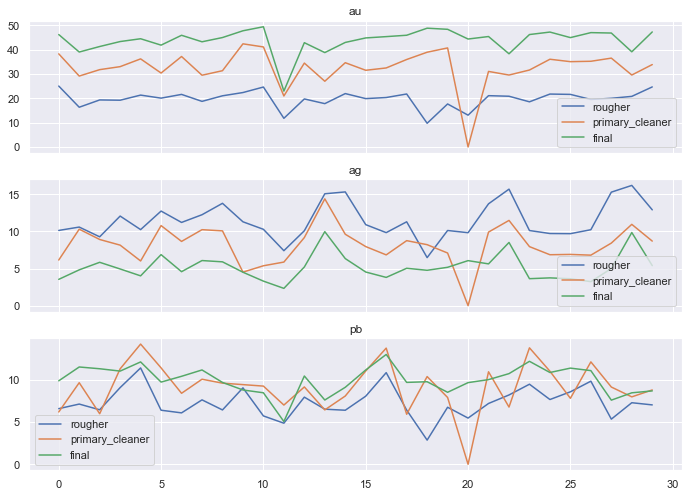

In [53]:

train = preparing('train')
train = preprocessing_dropna(train)
fig, ax = plt.subplots(3, sharex='all')
i = 0
for element in ['au', 'ag', 'pb']:
    print('Элемент {}'.format(element))
    rougher = train['rougher.output.concentrate_' + element].sample(30, random_state = RANDOM_STATE).reset_index(drop=True)
    primary_cleaner = train['primary_cleaner.output.concentrate_' + element].sample(30, random_state = RANDOM_STATE).reset_index(drop=True)
    final = train['final.output.concentrate_' + element].sample(30, random_state = RANDOM_STATE).reset_index(drop=True)

    rougher.plot.line(label='rougher', legend=True, title=element, ax=ax[i])
    primary_cleaner.plot.line(label='primary_cleaner', legend=True, ax=ax[i])
    final.plot.line(label='final', legend=True, ax=ax[i])
    i += 1
    pvalue = stats.ttest_ind(rougher, primary_cleaner)[1]
    print('        rougher-primary_cleaner pvalue: {:.2f}'.format(pvalue))
    pvalue = stats.ttest_ind(rougher, final)[1]
    print('        rougher-final pvalue: {:.2f}'.format(pvalue))  
    pvalue = stats.ttest_ind(primary_cleaner, final)[1]
    print('        primary_cleaner-final pvalue: {:.2f}'.format(pvalue))      

Для всех элементов концентрация на разных этапах различается и pvalue  не превышает 0.05. Но вообще этот момент не очень понятен:( чем больше выборка, тем меньше pvalue. Как происходит подбор размера выборки? В курсе просто делается выборка из 30 элементов, но почему именно 30 не говорится

<span style="color:Green">

**2019-12-29 DD**

Чем больше выборка, тем больше у нас уверенности в том, что рассчитанная статистика верна (меньше вариативности). Поэтому, p-value обычно падает с ростом выборки, если нулевая гипотеза действительно не подтверждается. Для теста выше можно было взять и всю выборку; значение равным 30, полагаю является некоторым таким эмперическим минимумом для теста Стьюдента. Если доступно больше данных, то лучше их все и использовать. 

</span>

Посмотрим на распределение размера гранул на тестовой и обучающей выборках

(735978.0, 736924.4583217592)

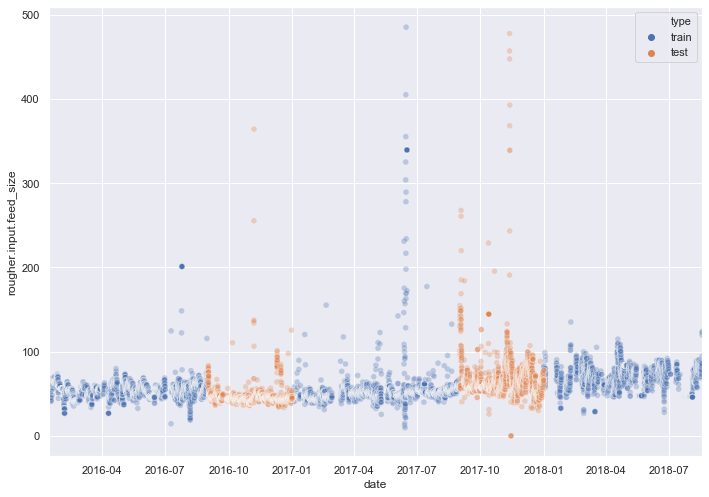

In [54]:
train = preparing('train')
test = preparing('test')
train = preprocessing_dropna(train)
test = preprocessing_dropna(test)

sns.set(rc={'figure.figsize':(11.7,8.27)})
train = train[['date', 'rougher.input.feed_size', 'primary_cleaner.input.feed_size']]
train['type'] = 'train'
test = test[['date', 'rougher.input.feed_size', 'primary_cleaner.input.feed_size']]
test['type'] = 'test'

train_test = pd.concat([train, test])

ax = sns.scatterplot(x='date', y='rougher.input.feed_size', hue='type', data=train_test, alpha=0.3)
ax.set_xlim(train_test['date'].min(), train_test['date'].max()) 

Данные из теста заполняют пропуски в данных конца года(сентябрь-декабрь). На глаз данные по размеру гранул не различаются. Проверим с помощью ttest_ind на сколько это правда

Сравнение rougher.input.feed_size на тесте и трейне, pvalue=0.6868


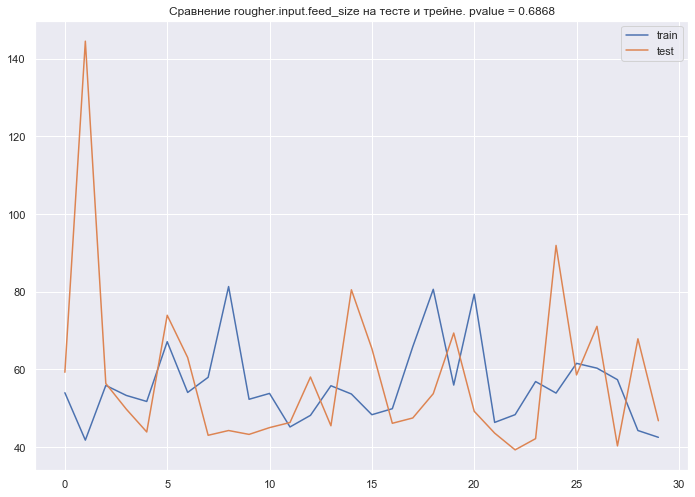

In [55]:
train = preparing('train')
test = preparing('test')
train = preprocessing_dropna(train)
test = preprocessing_dropna(test)

fig, ax = plt.subplots()
train_temp = train['rougher.input.feed_size'].sample(30, random_state=RANDOM_STATE).reset_index(drop=True)
test_temp = test['rougher.input.feed_size'].sample(30, random_state=RANDOM_STATE).reset_index(drop=True)

pvalue = stats.ttest_ind(train_temp, test_temp)[1]
train_temp.plot.line(label='train', legend=True, title='Сравнение rougher.input.feed_size на тесте и трейне. pvalue = {:.4f}'.format(pvalue))
test_temp.plot.line(label='test', legend=True)
print('Сравнение rougher.input.feed_size на тесте и трейне, pvalue={:.4f}'.format(pvalue))

С вероятностью 69% размер гранул в трейне и тесте совпадают. Модель построенная на трейне должна быть применима к тесту

<span style="color:Green">

**2019-12-29 DD**

Тут больше не тест Стьюдента уже просится, но тест сравнения распределения двух выборок, например, можно использовать Mann–Whitney U-test. Он тестирует являются ли две выборки выборками из одной и то же популяции.

</span>

Посмотрим как меняется суммарная концентрация веществ

(735978.125, 736924.4166550926)

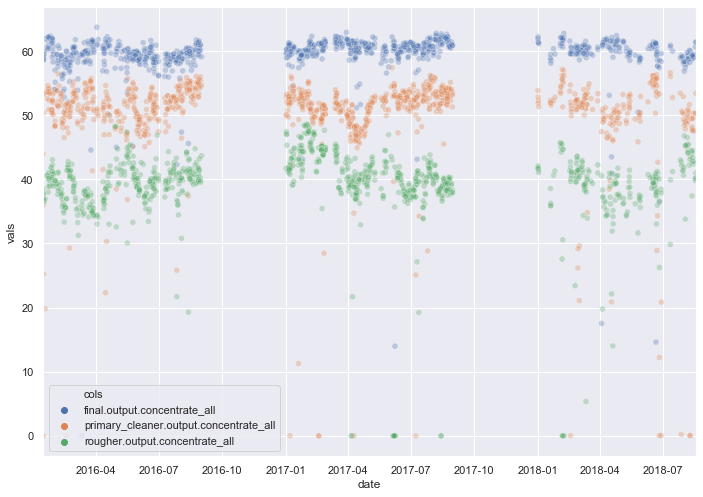

In [56]:
train = preparing('train')
train = preprocessing_dropna(train)
# train.info()
train = calculate_total_concentrate(train)
sns.set(rc={'figure.figsize':(11.7,8.27)})
train = train[['date','final.output.concentrate_all', 'primary_cleaner.output.concentrate_all', 'rougher.output.concentrate_all']].sample(1000).melt('date', var_name='cols', value_name='vals')
ax = sns.scatterplot(x='date', y='vals', hue='cols', data=train, alpha=0.3, legend='brief')
ax.set_xlim(train['date'].min(), train['date'].max())

Проверим существуют ли случаи когда концентраци на следующем этапе очистки ниже чем не предыдущем. И посчитаем долю таких случаев

In [57]:
train = preparing('train')
train = preprocessing_dropna(train)
train = calculate_total_concentrate(train)

train['concentrate_error'] = train[['rougher.output.concentrate_all', 'primary_cleaner.output.concentrate_all', 'final.output.concentrate_all']].apply(concentrate_error, axis=1)
train['concentrate_error'].value_counts(normalize=True)


False    0.954616
True     0.045384
Name: concentrate_error, dtype: float64

Доля случаев когда концентрация падает 4.5%. Такие случаи вероятно связаны с ошибками учета концентрации. Такие данные не надо учитывать в трейне, но удалить в тесте мы их не можем

# 3. Модель

Как мы помним на тесте нет многих полей, поэтому нет смысла их использовать и в обучении. <br>
Порядок действий:
* Удалить поля которых нет в тесте
* Заполнить\удалить пропуски
* Так как мы будем проверять качество модели кросс-валидацией разбивать данные нам не нужно
* Построим модели для LR, DT и RF
* Т.к. мы максимизируем smape, то в качестве score для кросс-валидации будем использовать расчет smape :) не знаю на сколько это правильно, но звучит вроде норм

In [58]:
train = preparing('train')
train = calculate_total_concentrate(train)
train = drop_concentrate_error(train)
train = drop_columns(train)
train = preprocessing_dropna(train)

features = train.drop(columns=['rougher.output.recovery', 'final.output.recovery', 'date', 'month', 'year', 'doy'])

features = scaling(features, features_columns)
target_rougher = train['rougher.output.recovery']
target_final = train['final.output.recovery']


print('Модель LR:')
model = LinearRegression()
print('    sMAPE: {:.4f}'.format(calculate_cross_val_result_smape_score(model, features, target_rougher, target_final)))

Модель LR:
    sMAPE: 11.8086


In [59]:
print('Модель DT:')

for max_depth in range(1, 10):
    model = DecisionTreeRegressor(random_state=RANDOM_STATE, max_depth = max_depth)
    print('    max_depth = {}, sMAPE: {:.4f}'.format(max_depth, calculate_cross_val_result_smape_score(model, features, target_rougher, target_final)))

Модель DT:
    max_depth = 1, sMAPE: 8.8890
    max_depth = 2, sMAPE: 10.5271
    max_depth = 3, sMAPE: 11.7217
    max_depth = 4, sMAPE: 10.9886
    max_depth = 5, sMAPE: 11.6258
    max_depth = 6, sMAPE: 11.8652
    max_depth = 7, sMAPE: 12.8838
    max_depth = 8, sMAPE: 13.6430
    max_depth = 9, sMAPE: 13.4233


In [60]:
print('Модель RF:')
model = RandomForestRegressor(random_state=RANDOM_STATE, n_estimators=100)
print('    n_estimators = 100, sMAPE: {:.4f}'.format(calculate_cross_val_result_smape_score(model, features, target_rougher, target_final)))

Модель RF:
    n_estimators = 100, sMAPE: 10.2622


#### Минимальный sMAPE получается при использовании RF c n_estimators=100, sMAPE: 8.8. Правда работает медленно :(

Изначально мы пошли по простому пути удаления строк с пропусками. Попробуем подойти более креативно. Известно, что данные идут в хронологической последовательности и данные меняются плавно, попробуем заполнить пропущенные значения линейной интерполяцией с помощью interpolate

<span style="color:Green">

**2019-12-29 DD**

>заполнить пропущенные значения линейной интерполяцией с помощью interpolate

Отличный ход, учитывая условия задачи!

</span>

In [61]:
train = preparing('train')
train = calculate_total_concentrate(train)
train = drop_concentrate_error(train)
train = drop_columns(train)
train = train.interpolate('linear')

features = train.drop(columns=['rougher.output.recovery', 'final.output.recovery', 'date', 'month', 'year', 'doy'])

features = scaling(features, features_columns)
target_rougher = train['rougher.output.recovery']
target_final = train['final.output.recovery']


print('Модель LR:')
model = LinearRegression()
print('    sMAPE: {:.4f}'.format(calculate_cross_val_result_smape_score(model, features, target_rougher, target_final)))

Модель LR:
    sMAPE: 16.6421


In [62]:
print('Модель DT:')

for max_depth in range(1, 10):
    model = DecisionTreeRegressor(random_state=RANDOM_STATE, max_depth = max_depth)
    print('    max_depth = {}, sMAPE: {:.4f}'.format(max_depth, calculate_cross_val_result_smape_score(model, features, target_rougher, target_final)))

Модель DT:
    max_depth = 1, sMAPE: 13.8602
    max_depth = 2, sMAPE: 13.8449
    max_depth = 3, sMAPE: 15.0329
    max_depth = 4, sMAPE: 14.9427
    max_depth = 5, sMAPE: 15.4164
    max_depth = 6, sMAPE: 15.3542
    max_depth = 7, sMAPE: 15.5549
    max_depth = 8, sMAPE: 16.4330
    max_depth = 9, sMAPE: 16.2891


In [63]:
print('Модель RF:')
model = RandomForestRegressor(random_state=RANDOM_STATE, n_estimators=100)
print('    n_estimators = 100, sMAPE: {:.4f}'.format(calculate_cross_val_result_smape_score(model, features, target_rougher, target_final)))

Модель RF:
    n_estimators = 100, sMAPE: 14.2217


#### При заполнении пропусков лучшее значение sMAPE: 13.93 получилось в модели DT max_depth=1<br>
Сравним какая из двух моделей покажет себя лучше на трейне, где мы можем заполнять пропуски, но не можем удалять строки

Расчет на тесте для модели RF n_estimators=100 с удалением пропусков на трейне и интерполяцией на тесте

In [64]:
train = preparing('train')
train = calculate_total_concentrate(train)
train = drop_concentrate_error(train)
train = drop_columns(train)
train = preprocessing_dropna(train)
test = preparing('test')
test = test.interpolate('linear')
full = preparing('full')


target_rougher_test = full.set_index('date')[['rougher.output.recovery']].join(test.set_index('date'), how='inner')['rougher.output.recovery']
target_final_test = full.set_index('date')[['final.output.recovery']].join(test.set_index('date'), how='inner')['final.output.recovery']

features_train = train[features_columns]
features_train = scaling(features_train, features_columns)
target_rougher_train = train['rougher.output.recovery']
target_final_train = train['final.output.recovery']

features_test = test[features_columns]
features_test = scaling(features_test, features_test.columns)

model = RandomForestRegressor(random_state=RANDOM_STATE, n_estimators=100)
model.fit(features_train, target_rougher_train)
prediction_rougher = model.predict(features_test)
model.fit(features_train, target_final_train)
prediction_final = model.predict(features_test)


smape1 = calculate_smape(target_rougher_test, prediction_rougher)
smape2 = calculate_smape(target_final_test, prediction_final)

print('sMAPE: {}'.format(smape1*0.25 + smape2*0.75))

sMAPE: 9.503272932669567


Расчет на тесте для модели DT max_depth=1 с интерполяцией на трейне и тесте

In [65]:
train = preparing('train')
train = calculate_total_concentrate(train)
train = drop_concentrate_error(train)
train = drop_columns(train)
train = preprocessing_dropna(train)
test = preparing('test')
test = test.interpolate('linear')
full = preparing('full')


target_rougher_test = full.set_index('date')[['rougher.output.recovery']].join(test.set_index('date'), how='inner')['rougher.output.recovery']
target_final_test = full.set_index('date')[['final.output.recovery']].join(test.set_index('date'), how='inner')['final.output.recovery']

features_train = train[features_columns]
features_train = scaling(features_train, features_columns)
target_rougher_train = train['rougher.output.recovery']
target_final_train = train['final.output.recovery']

features_test = test[features_columns]
features_test = scaling(features_test, features_test.columns)

model = DecisionTreeRegressor(random_state=RANDOM_STATE, max_depth = 1)
model.fit(features_train, target_rougher_train)
prediction_rougher = model.predict(features_test)
model.fit(features_train, target_final_train)
prediction_final = model.predict(features_test)


smape1 = calculate_smape(target_rougher_test, prediction_rougher)
smape2 = calculate_smape(target_final_test, prediction_final)

print('sMAPE: {}'.format(smape1*0.25 + smape2*0.75))

sMAPE: 9.775863822430914


#### Лучшее значение на тесте sMAPE=9.5 получилось достичь при удалении пропусков на трейне и заполнением пропусков с помощью интерполяции на тесте

<span style="color:Green">

**2019-12-29 DD**

Логика верна, проект принимается. Но в реальной жизни, возможно, пропуски нам не дали бы удалить.

</span>

- [x]  Jupyter Notebook открыт
- [x]  Весь код выполняется без ошибок
- [x]  Ячейки с кодом расположены в порядке выполнения
- [x]  Выполнен шаг 1: данные подготовлены
    - [x]  Проверена формула вычисления эффективности обогащения
    - [x]  Проанализированы признаки, недоступные в тестовой выборке
    - [x]  Проведена предобработка данных
- [x]  Выполнен шаг 2: данные проанализированы
    - [x]  Исследовано изменение концентрации элементов на каждом этапе
    - [x]  Проанализированы распределения размеров гранул на обучающей и тестовой выборках
    - [x]  Исследованы суммарные концентрации
    - [x]  Проанализированы и обработаны аномальные значения
- [x]  Выполнен шаг 3: построена модель прогнозирования
    - [x]  Написана функция для вычисления итогового *sMAPE*
    - [x]  Обучено и проверено несколько моделей
    - [x]  Выбрана лучшая модель, её качество проверено на тестовой выборке